# Cassava Leaf Disease Classification Project

## Part 1: Import Packages and the Dataset

#### Import Packages

In [3]:
import pandas as pd
import numpy as np
from sklearn.dummy import DummyClassifier
from google.colab import files
import pandas as pd
import io
from keras.preprocessing.image import img_to_array, load_img, ImageDataGenerator
from google.colab import drive
import json

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.image as mpimg
import random
import tensorflow as tf
import cv2
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib import colors

In [5]:
# Example submission notebook for the midterm-project in the
# Brown Data Science DATA2040 Deep Learning course. 
# Please visit dsi.brown.edu for information on the Data Sciene Masters Program.
# The web page for this course is data2040.github.io 
# Authors: Kaiwen Yang, Dan Potter

# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load
from functools import partial

import tensorflow.keras as keras
import keras
from keras.layers import Dense, Dropout, Input, MaxPooling2D, ZeroPadding2D, Conv2D, Flatten
from keras.models import Sequential, Model
from keras.losses import categorical_crossentropy
from keras.optimizers import Adam, SGD
from keras.callbacks import EarlyStopping
from keras.preprocessing.image import img_to_array, load_img, ImageDataGenerator
from keras.utils import to_categorical
from tensorflow.keras import regularizers
from tensorflow.keras.layers import MaxPool2D, AveragePooling2D, GlobalAveragePooling2D
from sklearn.model_selection import train_test_split

from mpl_toolkits.axes_grid1 import ImageGrid

from zipfile import ZipFile
import time
from datetime import timedelta
from io import BytesIO

# Image manipulation.
import PIL.Image
import pickle
import os
import random
from tensorflow import keras
import tensorflow as tf


# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

### Load the Dataset

In [6]:
import zipfile
drive.mount("/content/gdrive", force_remount=True)

Mounted at /content/gdrive


In [7]:
# load train dataset for EDA
df_train = pd.read_csv('/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/train.csv')
df_train

,image_id,label
0,1000015157.jpg,0
1,1000201771.jpg,3
2,100042118.jpg,1
3,1000723321.jpg,1
4,1000812911.jpg,3
...,...,...
21392,999068805.jpg,3
21393,999329392.jpg,3
21394,999474432.jpg,1
21395,999616605.jpg,4


In [8]:
submission = pd.read_csv('/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/sample_submission.csv')
submission

,image_id,label
0,2216849948.jpg,4


In [9]:
f = open('/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/label_num_to_disease_map.json')
label_name = json.load(f)
label_name

{'0': 'Cassava Bacterial Blight (CBB)',
 '1': 'Cassava Brown Streak Disease (CBSD)',
 '2': 'Cassava Green Mottle (CGM)',
 '3': 'Cassava Mosaic Disease (CMD)',
 '4': 'Healthy'}

In [10]:
print("Tensorflow version " + tf.__version__)

try:
  tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
  print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
except ValueError:
  raise BaseException('ERROR: Not connected to a TPU runtime; please see the previous cell in this notebook for instructions!')

tf.config.experimental_connect_to_cluster(tpu)
tf.tpu.experimental.initialize_tpu_system(tpu)
tpu_strategy = tf.distribute.TPUStrategy(tpu)


Tensorflow version 2.4.1
Running on TPU  ['10.1.221.170:8470']
INFO:tensorflow:Initializing the TPU system: grpc://10.1.221.170:8470


INFO:tensorflow:Initializing the TPU system: grpc://10.1.221.170:8470


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Found TPU system:


INFO:tensorflow:Found TPU system:


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


In [11]:
f = open('/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/kaggle.json')
kaggle = json.load(f)
kaggle

{'key': '083bf009d9ae3ccc39aef8c4627c217d', 'username': 'yunxuanzeng'}

**Add paths to images**

In [12]:
path_org = '/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/train_images/'
path_img = df_train['image_id']
df_train['path'] = path_org + df_train['image_id']
df_train.head()

,image_id,label,path
0,1000015157.jpg,0,/content/gdrive/Shareddrives/2040 (unofficial)...
1,1000201771.jpg,3,/content/gdrive/Shareddrives/2040 (unofficial)...
2,100042118.jpg,1,/content/gdrive/Shareddrives/2040 (unofficial)...
3,1000723321.jpg,1,/content/gdrive/Shareddrives/2040 (unofficial)...
4,1000812911.jpg,3,/content/gdrive/Shareddrives/2040 (unofficial)...


In [13]:
## Part 2: Helper Functions

In [18]:
def get_image(path):
  path_org = '/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/train_images/'
  img = mpimg.imread(path_org + path)
  return img

In [19]:
def plot_class_image(disease_class):
  df_0 = df_train[df_train['label'] == disease_class]
  fig, axes = plt.subplots(2, 2, figsize = (10, 8))
  image_0 = list(df_0['image_id'])
  idx = 0
  for row in range(2):
    for col in range(2):
      path_tmp = image_0[idx]
      axes[row, col].imshow(get_image(path_tmp))
      idx += 1
      axes[row, col].axis('off') 
  fig.tight_layout()  

**Example:**

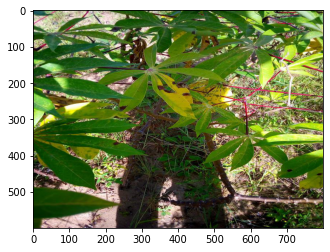

In [17]:
img_tmp = df_train['image_id'][0]
img1 = get_image(img_tmp)
plt.imshow(img1)

## Part 3: Exploratory Data Analysis

Imbalance, Encoders, Image Category Comparsion

### Sample Size

**Train Size**

In [20]:
df_train.shape

(21397, 3)

**Explanation:** There are 21397 samples in the training dataset, which is a large size dataset.

**Submission Size**

In [21]:
submission.shape

(1, 2)

**Explanation:** There is only one sample in the sample_submission dataset.

### Missing Value

In [22]:
perc_missing_per_ftr = df_train.isnull().sum(axis=0)/df_train.shape[0]
print(df_train.isnull().sum(axis = 0))
print('fraction of missing values in features:')
print(perc_missing_per_ftr[perc_missing_per_ftr > 0])
print('data types of the features with missing values:')
print(df_train[perc_missing_per_ftr[perc_missing_per_ftr > 0].index].dtypes)

image_id    0
label       0
path        0
dtype: int64
fraction of missing values in features:
Series([], dtype: float64)
data types of the features with missing values:
Series([], dtype: object)


**Explanation:** From the data above, it's clear to see that there is no need to deal with missing values. 

### Imbalance

In [23]:
print(df_train.label.value_counts())

3    13158
4     2577
2     2386
1     2189
0     1087
Name: label, dtype: int64


In [24]:
label_name = {int(k):v for k, v in label_name.items()}

In [25]:
df_cnt = df_train['label'].value_counts()
df_cnt.index.astype('str')
df_cnt = df_cnt.rename(index = label_name)
df_cnt

Cassava Mosaic Disease (CMD)           13158
Healthy                                 2577
Cassava Green Mottle (CGM)              2386
Cassava Brown Streak Disease (CBSD)     2189
Cassava Bacterial Blight (CBB)          1087
Name: label, dtype: int64

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


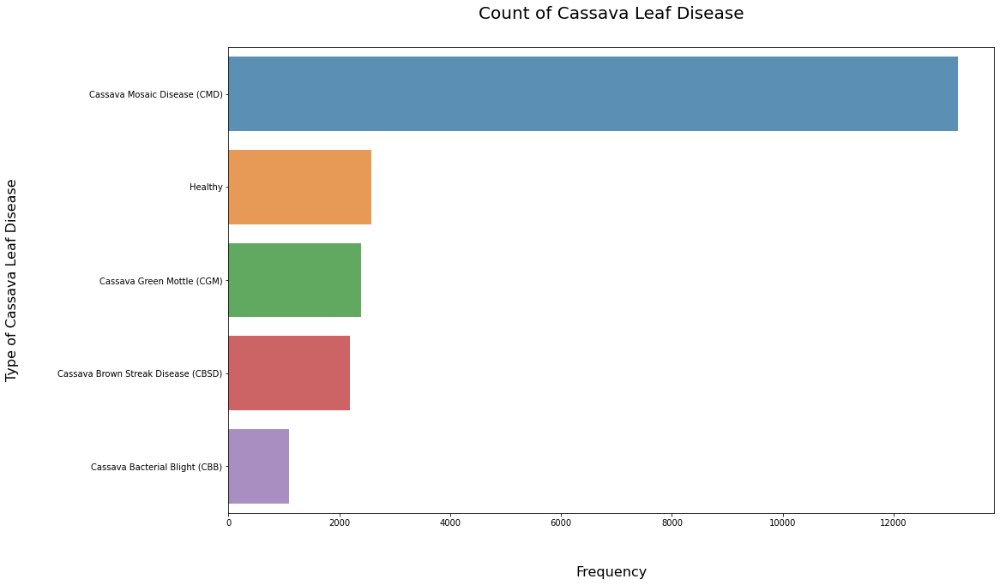

In [26]:
plt.figure(figsize=(16,10))
sns.barplot(df_cnt.values, df_cnt.index, alpha=0.8, orient = "h")
plt.ylabel('Type of Cassava Leaf Disease', labelpad = 45, fontsize = 16)
plt.xlabel('Frequency', labelpad=45, fontsize = 16)
plt.title("Count of Cassava Leaf Disease", y = 1.05, fontsize = 20)
plt.show()

**Explanation: From the plot above, we can see that there exist imbalance in this image dataset where `Cassava Mosaic Disease (CMD)` has over 13000 samples and `Cassava Bacterial Blight (CBB)` has only around 1087 samples**

In [27]:
from imblearn.under_sampling import TomekLinks
tl = TomekLinks(return_indices = True, ratio = 'majority')

/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


### Images of Each Class

In [28]:
df_train['label_name'] = df_train['label'].map(label_name)
df_train.head()

,image_id,label,path,label_name
0,1000015157.jpg,0,/content/gdrive/Shareddrives/2040 (unofficial)...,Cassava Bacterial Blight (CBB)
1,1000201771.jpg,3,/content/gdrive/Shareddrives/2040 (unofficial)...,Cassava Mosaic Disease (CMD)
2,100042118.jpg,1,/content/gdrive/Shareddrives/2040 (unofficial)...,Cassava Brown Streak Disease (CBSD)
3,1000723321.jpg,1,/content/gdrive/Shareddrives/2040 (unofficial)...,Cassava Brown Streak Disease (CBSD)
4,1000812911.jpg,3,/content/gdrive/Shareddrives/2040 (unofficial)...,Cassava Mosaic Disease (CMD)


In [29]:
label_name

{0: 'Cassava Bacterial Blight (CBB)',
 1: 'Cassava Brown Streak Disease (CBSD)',
 2: 'Cassava Green Mottle (CGM)',
 3: 'Cassava Mosaic Disease (CMD)',
 4: 'Healthy'}

#### Cassava Bacterial Blight (CBB)

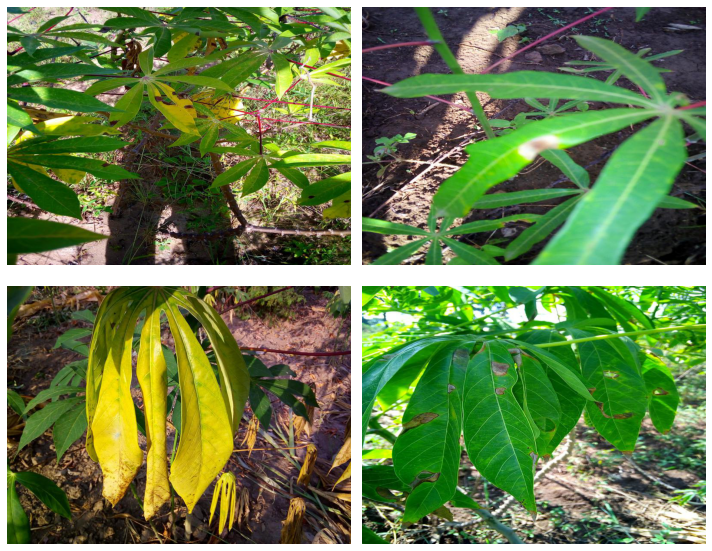

In [30]:
plot_class_image(0)

#### Cassava Brown Streak Disease (CBSD)

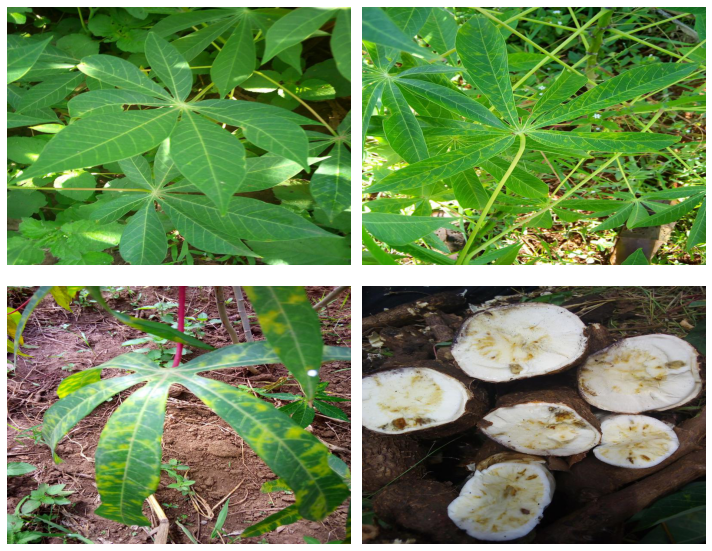

In [31]:
plot_class_image(1)

#### Cassava Green Mottle (CGM)

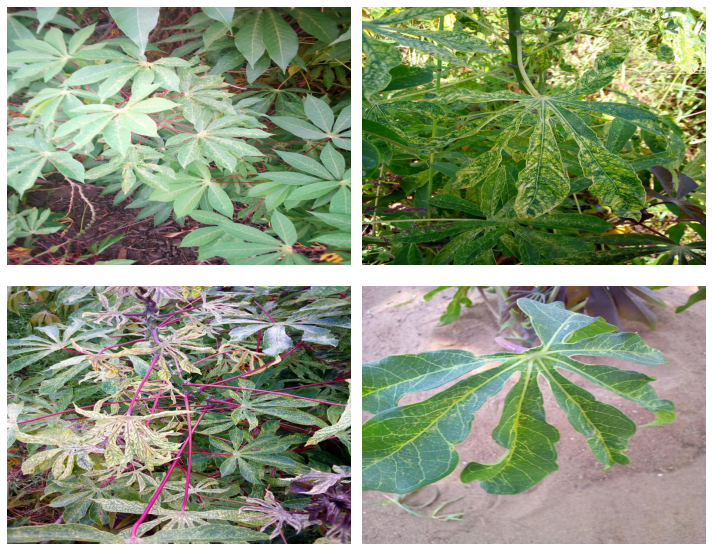

In [32]:
plot_class_image(2)

#### Cassava Mosaic Disease (CMD)

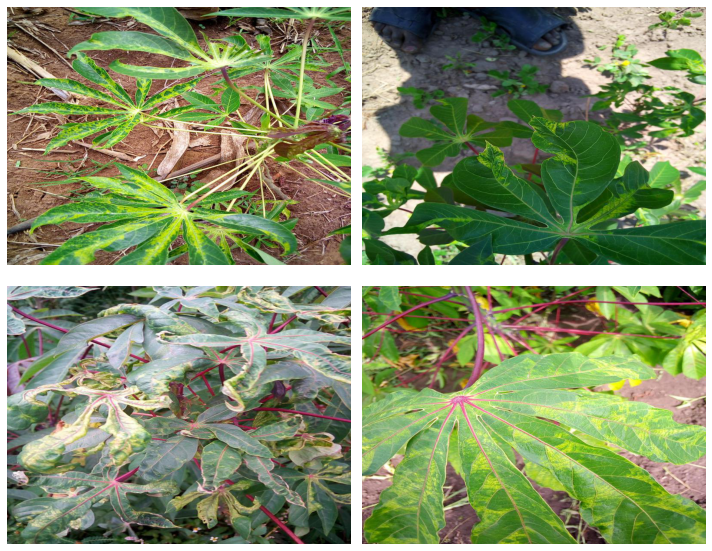

In [33]:
plot_class_image(3)

#### Healthy

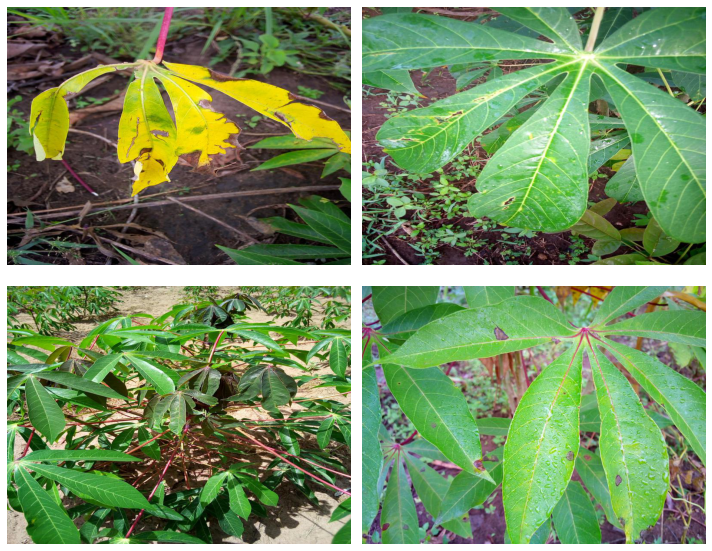

In [34]:
plot_class_image(4)

**Explaination:** By randomly picking up differnt types of leaf diseases and healthy leaves, we can get a geneal visualization from above.

### RGB Information

**Select a Random Image**

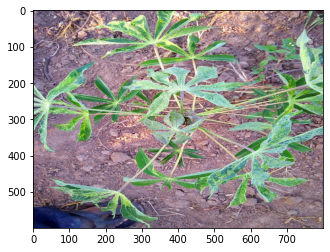

In [35]:
img_tmp = df_train['image_id'][16]
img_rgb = get_image(img_tmp)
plt.imshow(img_rgb)

#### RGB Channels

**Basic Properties of the Image**

In [36]:
print('Image Type: ',type(img_rgb))
print('Image Hight: ',img_rgb.shape[0])
print('Image Width: ',img_rgb.shape[1])
print('Image Dimension:', img_rgb.ndim)
print('Image size:', img_rgb.size)
print()
print("RGB Information:")
print('The maximum RGB value in this image {}'.format(img_rgb.max()))
print('The minimum RGB value in this image {}'.format(img_rgb.min()))

print('Value of only R channel {}'.format(img_rgb[ 100, 50, 0]))
print('Value of only G channel {}'.format(img_rgb[ 100, 50, 1]))
print('Value of only B channel {}'.format(img_rgb[ 100, 50, 2]))

Image Type:  <class 'numpy.ndarray'>
Image Hight:  600
Image Width:  800
Image Dimension: 3
Image size: 1440000

RGB Information:
The maximum RGB value in this image 255
The minimum RGB value in this image 0
Value of only R channel 129
Value of only G channel 106
Value of only B channel 132


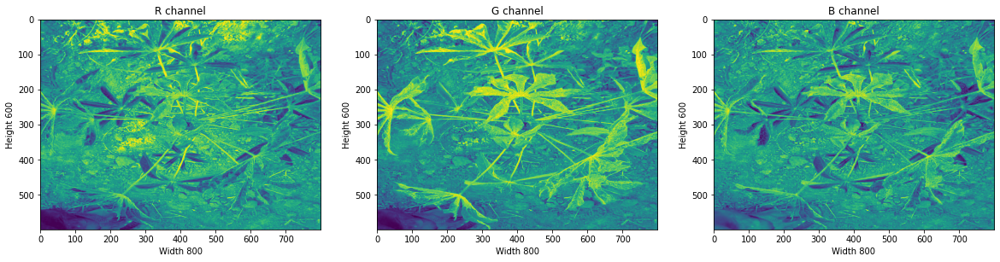

In [37]:
fig, ax = plt.subplots(1, 3, figsize=(20,20))

ax[0].set_title('R channel')
ax[0].set_ylabel('Height {}'.format(img_rgb.shape[0]))
ax[0].set_xlabel('Width {}'.format(img_rgb.shape[1]))
ax[0].imshow(img_rgb[ : , : , 0])

ax[1].set_title('G channel')
ax[1].set_ylabel('Height {}'.format(img_rgb.shape[0]))
ax[1].set_xlabel('Width {}'.format(img_rgb.shape[1]))
ax[1].imshow(img_rgb[ : , : , 1])

ax[2].set_title('B channel')
ax[2].set_ylabel('Height {}'.format(img_rgb.shape[0]))
ax[2].set_xlabel('Width {}'.format(img_rgb.shape[1]))
ax[2].imshow(img_rgb[ : , : , 2])
plt.show()

#### Splitting Layers

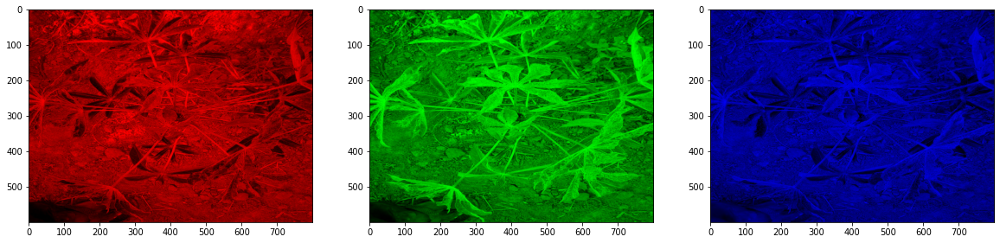

In [38]:
fig, ax = plt.subplots(nrows = 1, ncols=3, figsize=(20,20))  
for i, ax in zip(range(3), ax):     
     split_img = np.zeros(img_rgb.shape, dtype="uint8")
     split_img[ :, :, i] = img_rgb[ :, :, i]
     ax.imshow(split_img)

**Explanation:** From both plots, we are able to see that each pixel of the image is displaed by three distrinct integers. The shape of image is a three-layered matrix, where 0 indicates red channel, 1 indicates green channel and 2 indicate blue channels.

### The Colored 3D Scatter Plot for the Image ###

#### RGB Color Space

**Select a Random Image**

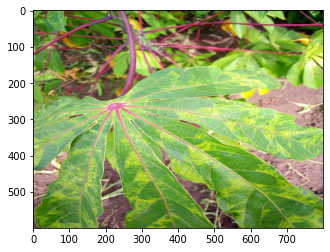

In [39]:
img_tmp = df_train['image_id'][9]
img_3d = get_image(img_tmp)
plt.imshow(img_3d)

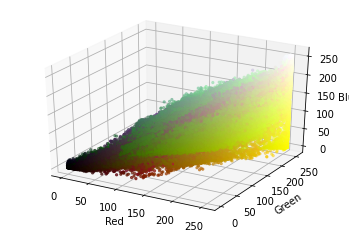

In [40]:
r, g, b = cv2.split(img_3d)
fig = plt.figure()
axis = fig.add_subplot(1, 1, 1, projection="3d")

pixel_colors = img_3d.reshape((np.shape(img_3d)[0]*np.shape(img_3d)[1], 3))
norm = colors.Normalize(vmin=-1.,vmax=1.)
norm.autoscale(pixel_colors)
pixel_colors = norm(pixel_colors).tolist()

axis.scatter(r.flatten(), g.flatten(), b.flatten(), facecolors=pixel_colors, marker=".")
axis.set_xlabel("Red")
axis.set_ylabel("Green")
axis.set_zlabel("Blue")
plt.show()

**Explanation:** From the plot above, we can see that the green parts of the image span across almost the entire range of green, red, and blue values. We are also able to see parts of green stretch over the whole plot so that it could be hard to segment leafs out in RGB space based on ranges of RGB values.

#### The HSV Color Space

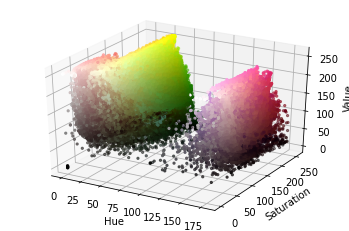

In [41]:
hsv_3d = cv2.cvtColor(img_3d, cv2.COLOR_RGB2HSV)

h, s, v = cv2.split(hsv_3d)
fig = plt.figure()
axis = fig.add_subplot(1, 1, 1, projection="3d")

axis.scatter(h.flatten(), s.flatten(), v.flatten(), facecolors=pixel_colors, marker=".")
axis.set_xlabel("Hue")
axis.set_ylabel("Saturation")
axis.set_zlabel("Value")
plt.show()

**Explanation:** It's clear to see that the leaf's greens are much more localized and visually separable. In other word, we can find that although the saturation and value of the greens change, they are mostly located within in a specific range with respect to the hue axis. Therefore, it could be less harder for us to do segmentaion or extract some important information.  

### Image Augmentation

#### Random Rotations

In [42]:
# https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html
data_generator_rotation = ImageDataGenerator(
    rotation_range=30,
    fill_mode='nearest')

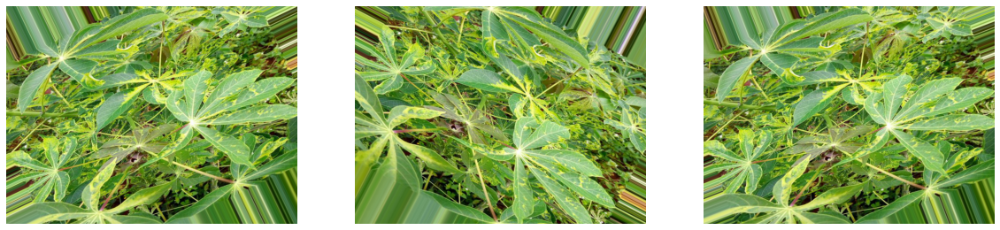

In [43]:
img_aug = df_train['image_id'][10]
img_aug = get_image(img_aug)
x = img_to_array(img_aug) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_rotation.flow(x, batch_size=1)

fig, ax = plt.subplots(1, 3, figsize=(20,20))

for i in range(3):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

#### Random Shifts

In [44]:
data_generator_shift = ImageDataGenerator(
    width_shift_range=0.3, 
    height_shift_range=0.3,
    fill_mode='nearest')

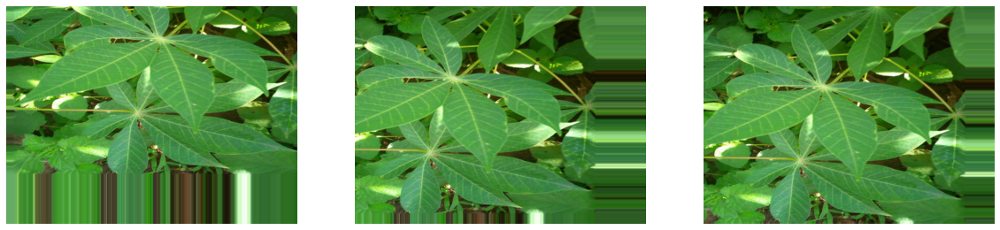

In [45]:
img_aug_1 = df_train['image_id'][2]
img_aug_1 = get_image(img_aug_1)
x = img_to_array(img_aug_1) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_shift.flow(x, batch_size=1)

fig, ax = plt.subplots(1, 3, figsize=(20,20))

for i in range(3):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

#### Random Flips

In [46]:
data_generator_flip = ImageDataGenerator(
    horizontal_flip=True, 
    vertical_flip=True,
    fill_mode='nearest')

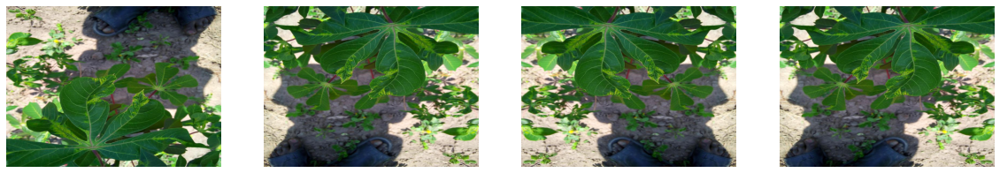

In [47]:
img_aug_2 = df_train['image_id'][4]
img_aug_2 = get_image(img_aug_2)
x = img_to_array(img_aug_2) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_flip.flow(x, batch_size=1)

fig, ax = plt.subplots(1, 4, figsize=(20,20))

for i in range(4):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

#### Random Brightness

In [48]:
data_generator_bright = ImageDataGenerator(
    brightness_range=[0.2,2.0],
    fill_mode='nearest')

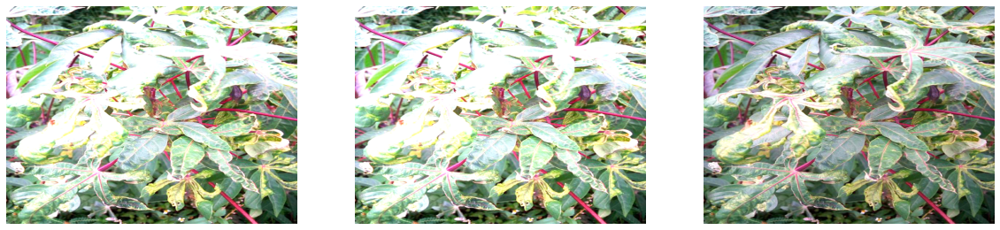

In [49]:
img_aug_2 = df_train['image_id'][5]
img_aug_2 = get_image(img_aug_2)
x = img_to_array(img_aug_2) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_bright.flow(x, batch_size=1)

fig, ax = plt.subplots(1, 3, figsize=(20,20))

for i in range(3):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

#### Random Zoom

In [50]:
data_generator_zoom = ImageDataGenerator(
    zoom_range=0.5)

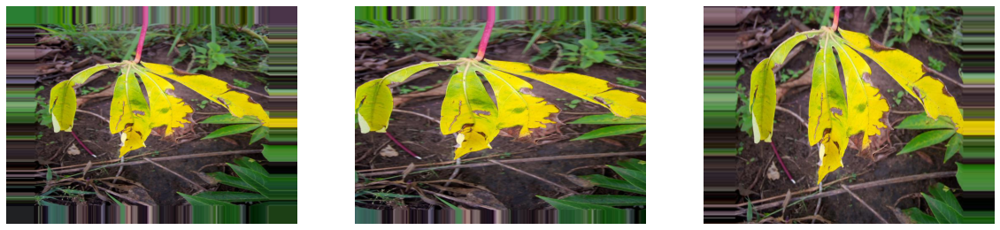

In [51]:
img_aug_2 = df_train['image_id'][8]
img_aug_2 = get_image(img_aug_2)
x = img_to_array(img_aug_2) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_zoom.flow(x, batch_size=1)

fig, ax = plt.subplots(1, 3, figsize=(20,20))

for i in range(3):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

##### Random Shear

In [52]:
data_generator_shear = ImageDataGenerator(
    shear_range=40)

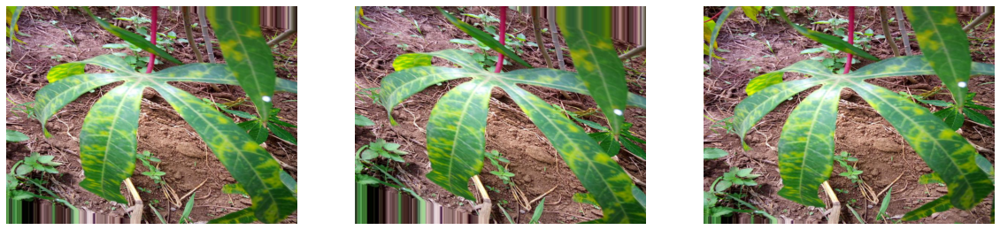

In [53]:
img_aug_2 = df_train['image_id'][12]
img_aug_2 = get_image(img_aug_2)
x = img_to_array(img_aug_2) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_shear.flow(x, batch_size=1)

fig, ax = plt.subplots(1, 3, figsize=(20,20))

for i in range(3):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

#### Put all things together

In [54]:
data_generator = ImageDataGenerator(
    width_shift_range=0.3, 
    height_shift_range=0.3,
    horizontal_flip=True, 
    vertical_flip=True,
    brightness_range=[0.5,1.5],
    zoom_range=0.5,
    shear_range=20,
    fill_mode='nearest')

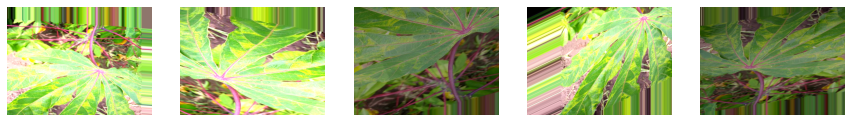

In [55]:
img_aug_2 = df_train['image_id'][9]
img_aug_2 = get_image(img_aug_2)
x = img_to_array(img_aug_2) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator.flow(x, batch_size=1)

fig, ax = plt.subplots(1, 5, figsize=(15,15))

for i in range(5):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

**Explanation:** We try to augmented the iamages using 'ImageDataGenerator()'. We use different augmentation techniques such as rotation, shifts, shear, zoom or flip. Therefore, we can make sure that the images are varied at each epoch for our model.

## Part 4: Baseline Model

#### Load Images

In [ ]:
train_labels = pd.read_csv('/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/train.csv')

In [ ]:
### https://www.kaggle.com/grantwiersum/cassava-disease-tfrecord-training
import glob
csv_df = pd.read_csv('/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/train.csv')
train_dir = '/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/train_tfrecords/*'
test_dir = '/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/test_tfrecords/*'
train_list = glob.glob(train_dir)
test_list = glob.glob(test_dir)
print("train: " + str(len(train_list)) + "\ntest: " + str(len(test_list)))

train: 16
test: 1


In [ ]:
labels = train_labels
labels.head()

,image_id,label
0,1000015157.jpg,0
1,1000201771.jpg,3
2,100042118.jpg,1
3,1000723321.jpg,1
4,1000812911.jpg,3


In [ ]:
labels['label']=labels['label'].astype(str)

In [ ]:
train_datagen = ImageDataGenerator(rescale=1./225,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    validation_split=0.3,
    horizontal_flip=True,)


test_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
train_dir = '/content/gdrive/Shareddrives/2040 (unofficial)/my_data/data/train_images/'

In [ ]:
train_generator = train_datagen.flow_from_dataframe(dataframe=labels,
      directory=train_dir,
      subset='training',
      x_col="image_id",
      y_col="label",
      shuffle=True,
      target_size=(150,150),
      batch_size=32,
      class_mode='categorical')

valid_generator = train_datagen.flow_from_dataframe(dataframe=labels,
      directory=train_dir,
      subset='validation',
      x_col="image_id",
      y_col="label",
      shuffle=True,
      target_size=(150,150),
      batch_size=32,
      class_mode='categorical')

Found 14978 validated image filenames belonging to 5 classes.
Found 6419 validated image filenames belonging to 5 classes.


#### Setup Tensorboard

In [ ]:
# setup tensorboard, directories
!rm -rf ./logs
!mkdir ./logs/
!mkdir ./logs/data2040_midterm_project



log_dir="./logs/data2040_midterm_project/"
def tensorboard_callback(exp_name):
  return tf.keras.callbacks.TensorBoard(log_dir=log_dir + exp_name, profile_batch=0, histogram_freq=1)
# launch tensorboard with specific directory
%load_ext tensorboard
%tensorboard --logdir logs/data2040_midterm_project


<IPython.core.display.Javascript object>

#### Build Baseline Model

In [ ]:
import keras
from keras.layers import Dense, Dropout, Input, MaxPooling2D, ZeroPadding2D, Conv2D, Flatten
from keras.models import Sequential, Model
from keras.losses import categorical_crossentropy
from keras.optimizers import Adam, SGD
from keras.preprocessing.image import img_to_array, load_img, ImageDataGenerator
from keras.utils import to_categorical
from tensorflow.keras import regularizers

from tensorflow.keras.layers import MaxPool2D, AveragePooling2D, GlobalAveragePooling2D
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

from zipfile import ZipFile
import time
from datetime import timedelta
from io import BytesIO

# Image manipulation.
import PIL.Image

import pickle
import os

import random

In [ ]:
def make_model_1():
    inputs = Input(shape = (150,150,3))
    model = Conv2D(filters=32, kernel_size=(3, 3),activation='softmax', input_shape=(150,150,3))(inputs)
    model = MaxPool2D(pool_size=(2, 2))(model)
    model = Conv2D(filters=64, kernel_size=(3, 3), activation='softmax')(model)
    model = MaxPool2D(pool_size=(2, 2))(model)
    model = Conv2D(filters=128, kernel_size=(3, 3), activation='softmax')(model)
    model = MaxPool2D(pool_size=(2, 2))(model)
    model = Flatten()(model)
    model = Dense(512, activation = "relu")(model)
    out = Dense(5, activation = 'softmax')(model)
    model = Model(inputs=inputs, outputs=out)
    
    model.compile(loss='categorical_crossentropy',
              optimizer=keras.optimizers.Adam(),
              metrics=['acc'])
    return model

In [ ]:
model = make_model_1()
print(model.summary())


Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 150, 150, 3)]     0         
_________________________________________________________________
conv2d (Conv2D)              (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 34, 34, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 17, 17, 128)       0     

In [ ]:
history = model.fit(train_generator,steps_per_epoch=20,
                    validation_data=valid_generator,validation_steps=20,
                    callbacks=[tensorboard_callback('baseline')], epochs=50
)
#EarlyStopping(monitor='val_acc',patience=10)

Epoch 1/50
20/20 [==============================] - 98s 5s/step - loss: 1.1803 - acc: 0.6234 - val_loss: 1.2011 - val_acc: 0.6031
Epoch 2/50
20/20 [==============================] - 97s 5s/step - loss: 1.1399 - acc: 0.6375 - val_loss: 1.1599 - val_acc: 0.6359
Epoch 3/50
20/20 [==============================] - 92s 5s/step - loss: 1.2310 - acc: 0.5922 - val_loss: 1.2109 - val_acc: 0.6109
Epoch 4/50
20/20 [==============================] - 97s 5s/step - loss: 1.1495 - acc: 0.6469 - val_loss: 1.2033 - val_acc: 0.6109
Epoch 5/50
20/20 [==============================] - 89s 4s/step - loss: 1.1994 - acc: 0.6109 - val_loss: 1.2092 - val_acc: 0.6000
Epoch 6/50
20/20 [==============================] - 91s 4s/step - loss: 1.2180 - acc: 0.6031 - val_loss: 1.1467 - val_acc: 0.6406
Epoch 7/50
20/20 [==============================] - 88s 4s/step - loss: 1.2314 - acc: 0.5906 - val_loss: 1.1932 - val_acc: 0.6156
Epoch 8/50
20/20 [==============================] - 88s 4s/step - loss: 1.2103 - acc: 0.60

In [ ]:
# save model
from keras.models import load_model
import os
def save_model(model, name):
  model_name = '{}.h5'.format(name)
  save_dir = os.path.join(os.getcwd(), 'saved_models')
  
  # Save model and weights
  if not os.path.isdir(save_dir):
      os.makedirs(save_dir)
  model_path = os.path.join(save_dir, model_name)
  model.save(model_path)
  print('Saved trained model at %s ' % model_path)

In [ ]:
save_model(model, 'baseline_model')

Saved trained model at /content/saved_models/baseline_model.h5 


In [ ]:
!tensorboard dev upload \
  --logdir logs \
  --name 'base model' \
  --one_shot

2021-02-22 01:05:43.038884: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1

***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

logs

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) yes

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scop

## References
1. Basic image data analysis using numpy and Opencv — Part 1. (n.d.). Retrieved February 21, 2021, from https://www.kdnuggets.com/2018/07/basic-image-data-analysis-numpy-opencv-p1.html

2. Real Python. (2020, November 07). Image segmentation using color spaces in opencv + python. Retrieved February 21, 2021, from https://realpython.com/python-opencv-color-spaces/

3. Chollet, F. (n.d.). The Keras BLOG. Retrieved February 21, 2021, from https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html

4. Lys620. (2021, February 13). Cassava-leaf-disease_simplecnn. Retrieved February 21, 2021, from https://www.kaggle.com/lys620/cassava-leaf-disease-simplecnn